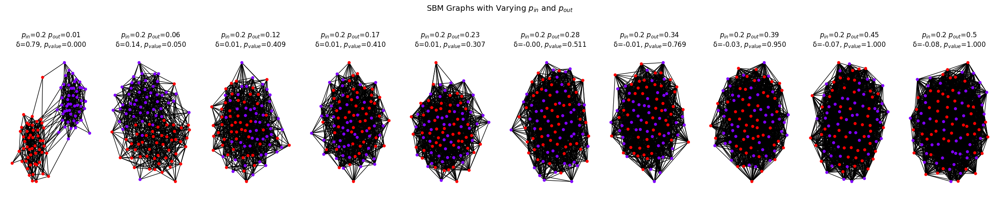

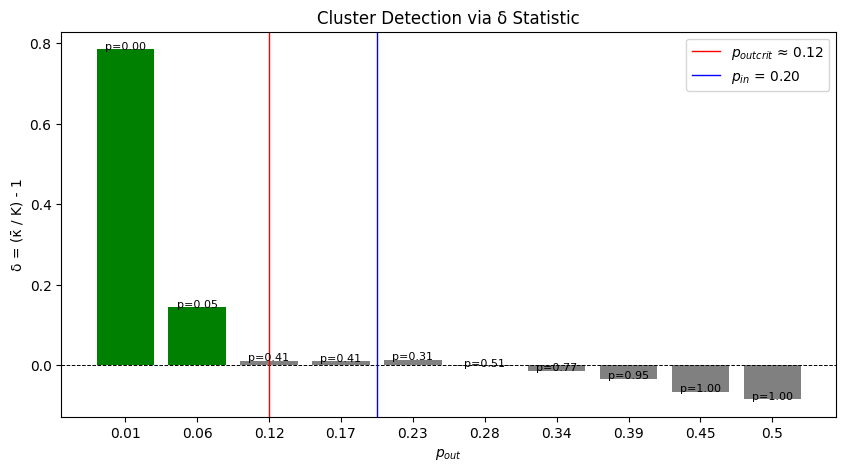

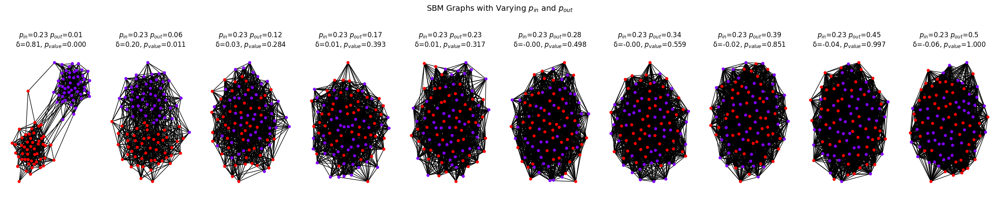

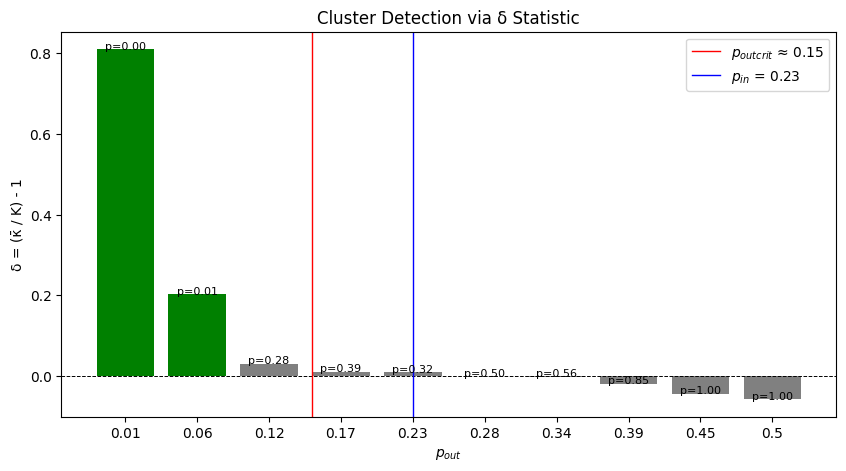

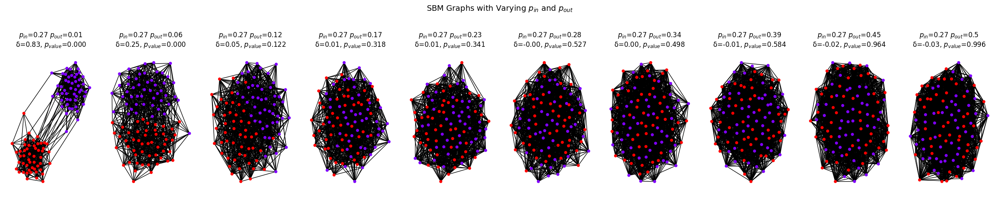

...

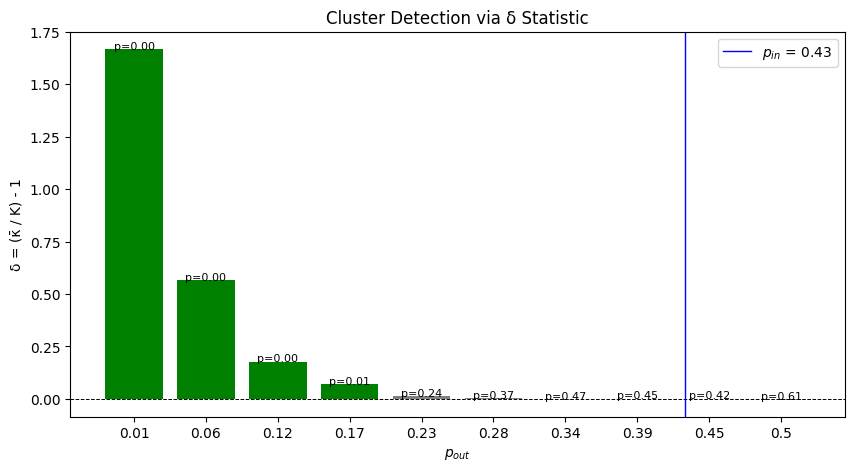

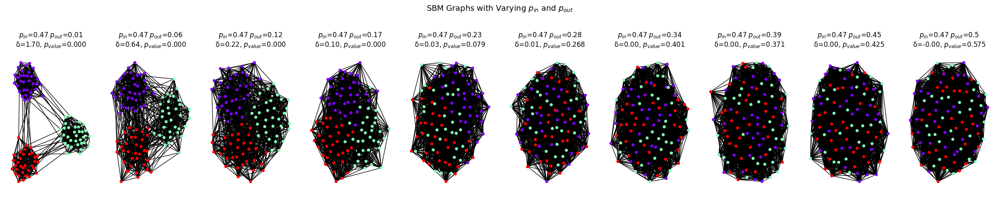

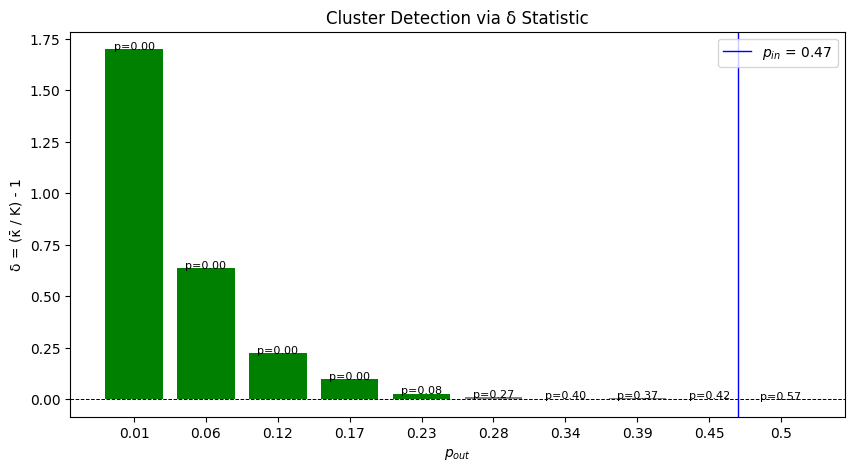

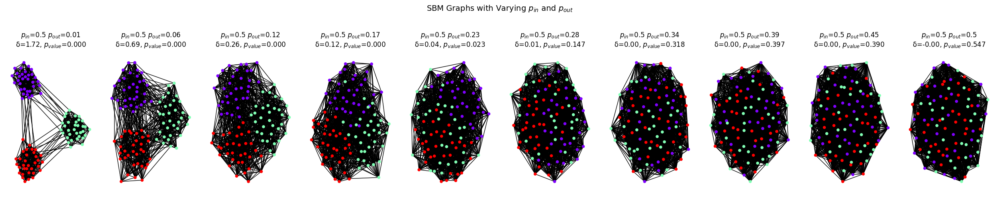

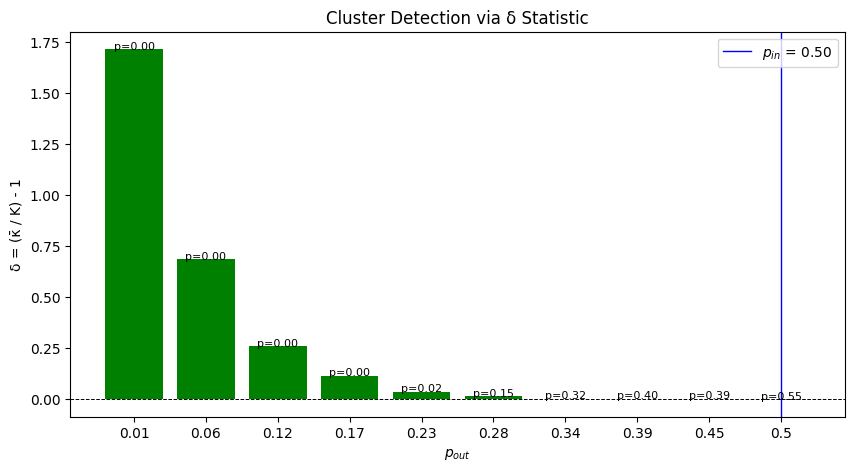

In [4]:
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from scipy.stats import norm, ttest_1samp

# Вычисляет локальную плотность узла в графе (доля связей между соседями)
def compute_local_density(G, node):
    neighbors = list(G.neighbors(node))  # Список соседей узла
    if len(neighbors) < 2:
        return 0  # Если меньше двух соседей — плотность 0
    subgraph = G.subgraph(neighbors)  # Подграф, состоящий из соседей
    possible_edges = len(neighbors) * (len(neighbors) - 1) / 2  # Максимально возможное число рёбер
    actual_edges = subgraph.number_of_edges()  # Фактическое количество рёбер между соседями
    return actual_edges / possible_edges  # Плотность — доля реальных рёбер от возможных

# Глобальная плотность графа (доля рёбер от максимально возможного количества)
def compute_global_density(G):
    n = G.number_of_nodes()
    possible_edges = n * (n - 1) / 2
    return G.number_of_edges() / possible_edges

# Критическое значение c_out, при котором становится невозможно обнаружить кластеры
def compute_c_out_critic(c_in):
    a = 1
    b = -2 * (c_in + 1)
    c = c_in**2 - 2 * c_in
    # Решение квадратного уравнения
    c_out_1 = (-b + np.sqrt(b**2 - 4*a*c)) / (2 * a)
    c_out_2 = (-b - np.sqrt(b**2 - 4*a*c)) / (2 * a)
    return min(c_out_1, c_out_2)  # Берём меньшее значение как критическое

# Проверка наличия кластерной структуры
def test_delta_statistic(G, s, seed, alpha=0.05):
    np.random.seed(seed)
    nodes = list(G.nodes())

    sampled_nodes = np.random.choice(nodes, size=s, replace=False)  # Случайная выборка узлов
    
    # Вычисление локальной плотности для выборки
    local_densities = [compute_local_density(G, v) for v in sampled_nodes]
    K_mean = np.mean(local_densities)  # Средняя локальная плотность
    K = compute_global_density(G)      # Глобальная плотность
    delta = (K_mean / K) - 1 if K > 0 else 0  # Разность плотностей δ

    # Одновыборочный t-тест на гипотезу: нулевая гипотеза - средняя локальная плотность равна глобальной, альтернатива - больше
    t_stat, p_value = ttest_1samp(local_densities, K, alternative='greater')

    has_clusters = p_value < alpha  # Если p-значение ниже уровня значимости — есть кластеры

    return has_clusters, delta, p_value

# Основная функция проверки кластеризуемости графа
def clusterability_test_delta(n, k, sample, num_test):
    # Значения плотности связей внутри и между кластерами
    c_in_values = np.linspace(20, 50, num=10)
    c_out_values = np.linspace(1, 50, num=10)
    
    p_in_values = [round(c_in / n, 2) for c_in in c_in_values]
    p_out_values = [round(c_out / n, 2) for c_out in c_out_values]
    
    # Перебор значений плотности внутри кластеров
    for c_in in c_in_values:
        p_in = round(c_in / n, 2)
        results = []
        
        # Подготовка визуализации для каждого p_out
        fig, axs = plt.subplots(1, len(p_out_values), figsize=(25, 5))
        fig.suptitle("SBM Graphs with Varying $p_{in}$ and $p_{out}$", fontsize=14)
        
        # Перебор значений плотности между кластерами
        for idx, c_out in enumerate(c_out_values):
            p_out = round(c_out / n, 2)
            sizes = [n // k] * k  # Размеры сообществ
            # Матрица вероятностей для SBM (Stochastic Block Model)
            probs = [[p_in if i == j else p_out for j in range(k)] for i in range(k)]
                    
            res_test = {'has_clusters': 0, 'delta': 0, 'p_value': 0}
            # Проведение num_test тестов для заданных p_in и p_out
            for num in range(num_test):
                G = nx.stochastic_block_model(sizes, probs, seed=20+num)  # Генерация графа
                
                has_clusters, delta, p_value = test_delta_statistic(G, s=sample, seed=20+num)
                res_test['has_clusters'] += int(has_clusters)
                res_test['delta'] += delta
                res_test['p_value'] += p_value

            # Усреднение результатов
            delta = res_test['delta'] / num_test
            has_clusters = 1 if res_test['has_clusters'] / num_test > 0.5 else 0
            p_value = res_test['p_value'] / num_test
            
            results.append((p_out, delta, has_clusters, p_value))
            
            pos = nx.spring_layout(G)  # Координаты узлов для отрисовки

            true_labels = []
            for i, size in enumerate(sizes):
                true_labels.extend([i] * size)
            
            # Визуализация графа
            nx.draw(G, pos, node_color=true_labels, cmap=plt.colormaps['rainbow'], node_size=20, ax=axs[idx])
            axs[idx].set_title(f"$p_{{in}}$={p_in} $p_{{out}}$={p_out}\nδ={delta:.2f}, $p_{{value}}$={p_value:.3f}")
            axs[idx].axis('off')
        
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()
        
        # График зависимости δ от p_out
        p_out_list, delta_list, detect_list, p_list = zip(*results)
        colors = ['green' if d else 'gray' for d in detect_list]  # Цвет в зависимости от наличия кластеров
        
        plt.figure(figsize=(10, 5))
        bars = plt.bar([str(p) for p in p_out_list], delta_list, color=colors)
        plt.axhline(0, color='black', linestyle='--', linewidth=0.7)
        x_pos = np.arange(len(p_out_list))

        # Отметка критического значения p_out (только для 2 кластеров)
        if k == 2:
            p_out_crit = round(compute_c_out_critic(c_in) / n, 2)
            x_out_crit = np.interp(p_out_crit, p_out_list, x_pos)
            plt.axvline(x=x_out_crit, color='red', linewidth=1, label=f'$p_{{out crit}}$ ≈ {p_out_crit:.2f}')
        # Отметка значения p_in
        x_in = np.interp(p_in, p_out_list, x_pos)
        plt.axvline(x=x_in, color='blue', linewidth=1, label=f'$p_{{in}}$ = {p_in:.2f}')
        
        plt.xlabel("$p_{{out}}$")
        plt.ylabel("δ = (κ̄ / K) - 1")
        plt.title("Cluster Detection via δ Statistic")

        # Подписи p-значений на графике
        for i, (d, p) in enumerate(zip(delta_list, p_list)):
            plt.text(i, d, f"p={p:.2f}", ha='center', fontsize=8)

        plt.legend(loc='upper right')
        plt.show()

# Параметры
N = 100
clusterability_test_delta(N, 2, 40, 10)  # Тест для 2 кластеров
clusterability_test_delta(N, 3, 40, 10)  # Тест для 3 кластеров


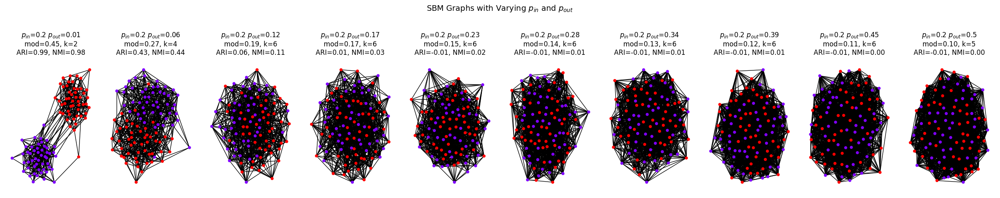

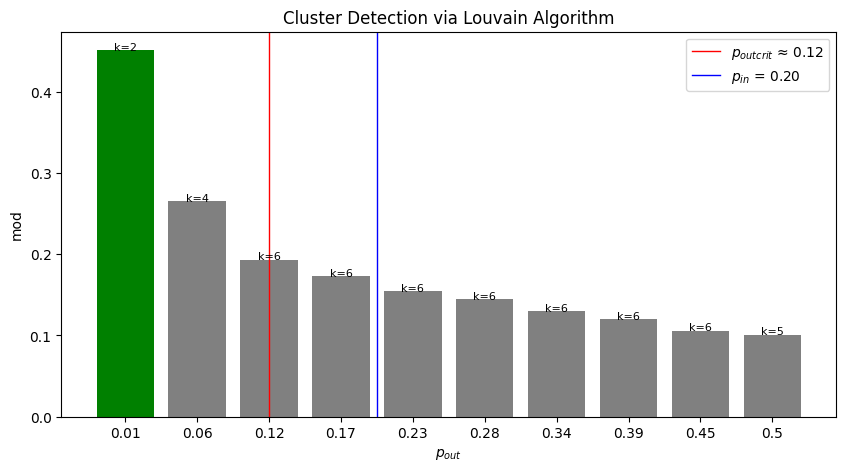

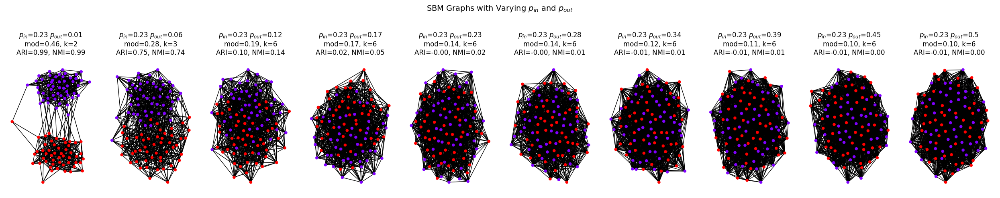

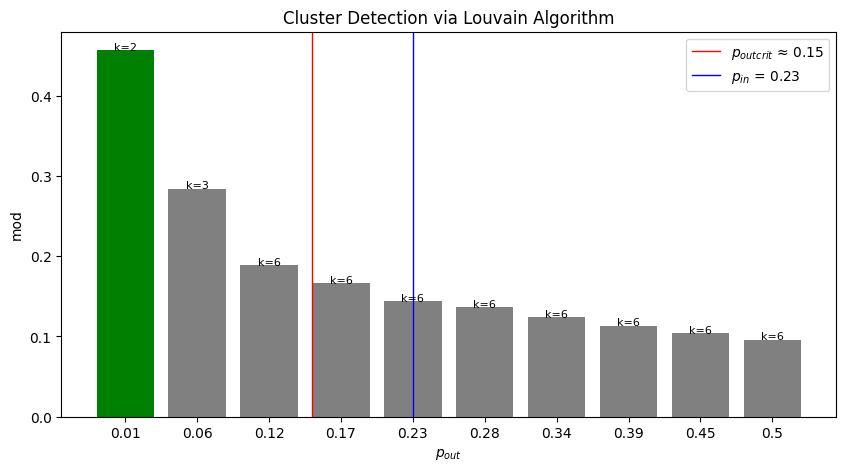

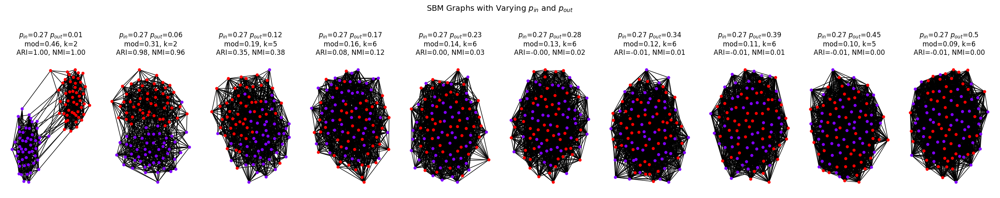

...

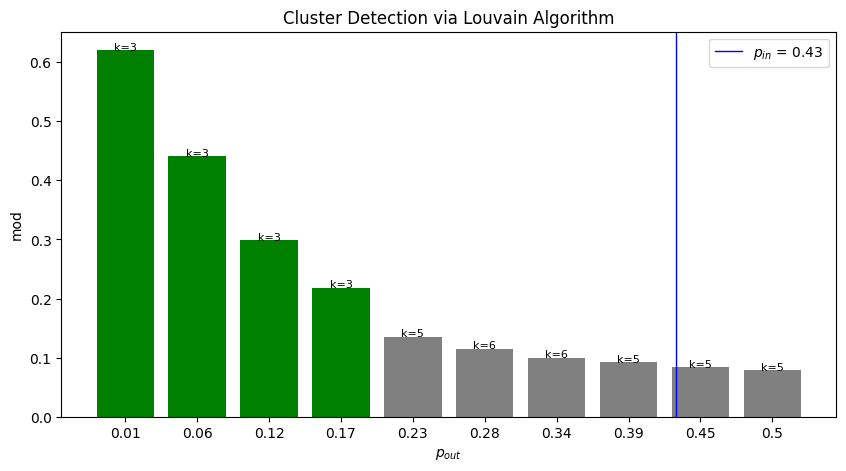

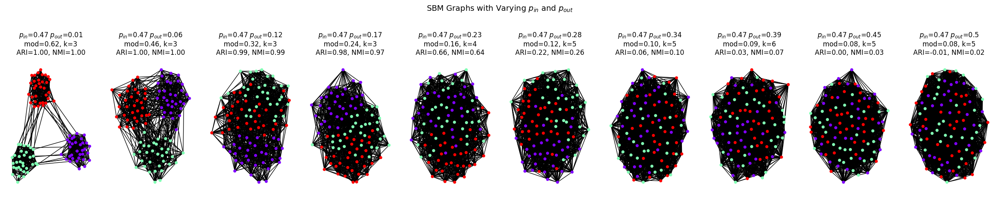

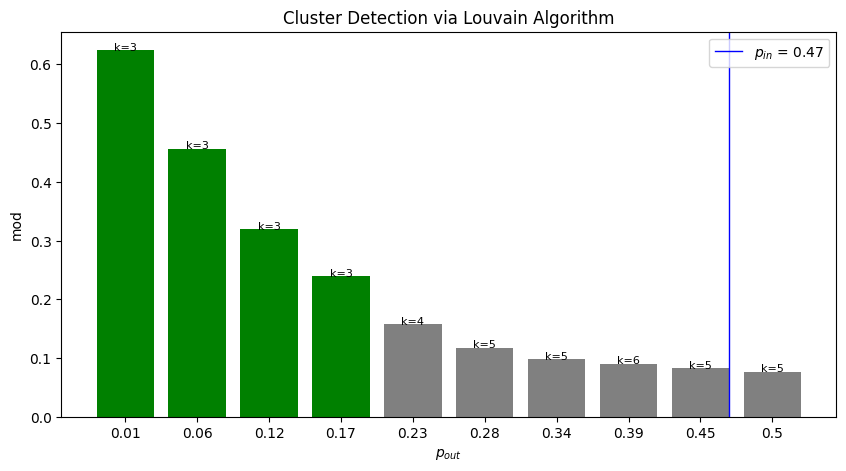

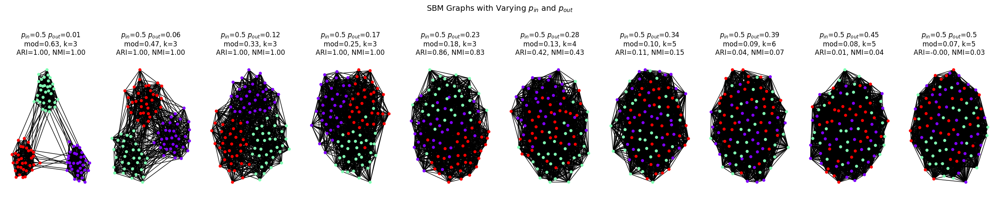

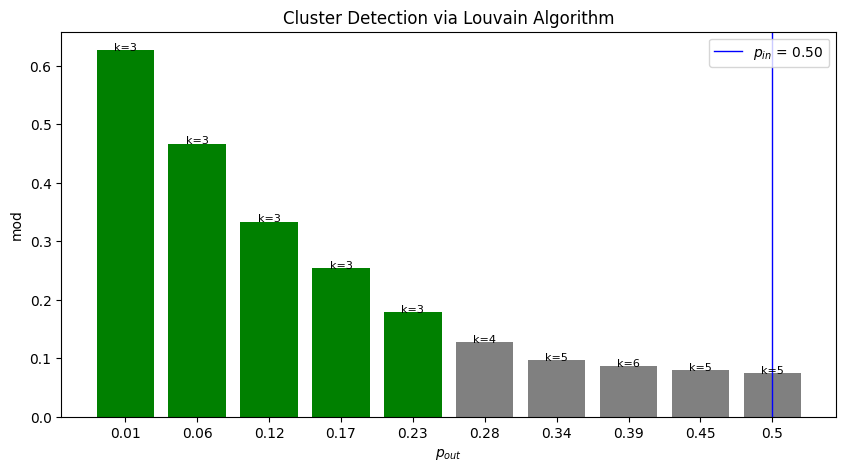

In [1]:
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from community import community_louvain
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score

# Вычисление критического значения c_out для обнаружения кластеров в SBM при k=2
def compute_c_out_critic(c_in):
    a = 1
    b = - 2 * (c_in + 1)
    c = c_in**2 - 2 * c_in
    c_out_1 =(-b + np.sqrt(b**2 - 4*a*c)) / (2 * a)
    c_out_2 =(-b - np.sqrt(b**2 - 4*a*c)) / (2 * a)
    return min(c_out_1, c_out_2)

# Применение Louvain алгоритма
def test_louvain_clusterability(G):
    if G.number_of_edges() == 0:
        return False, 0.0, 0, {}

    # Получение разбиения с помощью Louvain
    partition = community_louvain.best_partition(G)
    modularity = community_louvain.modularity(partition, G)  # Модулярность
    num_communities = len(set(partition.values()))  # Кол-во сообществ

    has_clusters = modularity > 1e-7  # Наличие кластеров
    return has_clusters, modularity, num_communities, partition

# Основной тест на кластеризуемость на основе Louvain
def clusterability_test_louvain(n, k, num_test):
    # Диапазоны для c_in и c_out
    c_in_values = np.linspace(20, 50, num=10)
    c_out_values = np.linspace(1, 50, num=10)
    
    # Преобразование в вероятности
    p_in_values = [round(c_in / n, 2) for c_in in c_in_values]
    p_out_values = [round(c_out / n, 2) for c_out in c_out_values]
    
    for c_in in c_in_values:
        p_in = round(c_in / n, 2)
        results = []
        
        fig, axs = plt.subplots(1, len(p_out_values), figsize=(25, 5))
        fig.suptitle("SBM Graphs with Varying $p_{in}$ and $p_{out}$", fontsize=14)
        
        for idx, c_out in enumerate(c_out_values):
            p_out = round(c_out / n, 2)
            sizes = [n // k] * k  # Размеры кластеров
            probs = [[p_in if i == j else p_out for j in range(k)] for i in range(k)]  # Матрица вероятностей

            res_test = {'has_clusters': 0, 'modularity': 0, 'num_communities': 0}
            ari_total = 0
            nmi_total = 0
            
            # Проведение num_test тестов для заданных p_in и p_out
            for num in range(num_test):
                G = nx.stochastic_block_model(sizes, probs, seed=20+num)
                
                # Истинные метки кластеров
                true_labels = []
                for i, size in enumerate(sizes):
                    true_labels.extend([i] * size)
                
                # Louvain кластеризация
                has_clusters, modularity, num_communities, partition = test_louvain_clusterability(G)
                
                # Полученные метки
                pred_labels = [partition.get(node, -1) for node in sorted(G.nodes())]
            
                # Вычисление ARI и NMI
                ari = adjusted_rand_score(true_labels, pred_labels)
                nmi = normalized_mutual_info_score(true_labels, pred_labels)
                
                ari_total += ari
                nmi_total += nmi
            
                res_test['has_clusters'] += has_clusters
                res_test['modularity'] += modularity
                res_test['num_communities'] += num_communities

            # Усреднение результатов
            modularity = res_test['modularity'] / num_test            
            num_communities = round(res_test['num_communities'] / num_test, 0)

            # Если кол-во найденных кластеров отличается от истинного, считаем, что кластеры не найдены
            if num_communities != k:
                has_clusters = 0
            else:
                has_clusters = 1

            ari_avg = ari_total / num_test
            nmi_avg = nmi_total / num_test
            
            results.append((p_out, modularity, has_clusters, num_communities))
            
            pos = nx.spring_layout(G)

            # Визуализация графа с истинными метками
            nx.draw(G, pos, node_color=true_labels, cmap=plt.colormaps['rainbow'], node_size=20, ax=axs[idx])

            axs[idx].set_title(f"$p_{{in}}$={p_in} $p_{{out}}$={p_out}\nmod={modularity:.2f}, k={num_communities:.0f}\nARI={ari_avg:.2f}, NMI={nmi_avg:.2f}")
            axs[idx].axis('off')
        
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()
        
        # Построение графика зависимости модулярности от p_out
        p_out_list, modularity_list, detect_list, num_comm = zip(*results)
        colors = ['green' if d else 'gray' for d in detect_list]
        
        plt.figure(figsize=(10, 5))
        bars = plt.bar([str(p) for p in p_out_list], modularity_list, color=colors)
        plt.axhline(0, color='black', linestyle='--', linewidth=0.7)
        x_pos = np.arange(len(p_out_list))

        # Вертикальные линии для p_in и критического p_out (только если k=2)
        if k == 2:
            p_out_crit = round(compute_c_out_critic(c_in) / n, 2)
            x_out_crit = np.interp(p_out_crit, p_out_list, x_pos)
            plt.axvline(x=x_out_crit, color='red', linewidth=1, label=f'$p_{{out crit}}$ ≈ {p_out_crit:.2f}')
        x_in = np.interp(p_in, p_out_list, x_pos)
        plt.axvline(x=x_in, color='blue', linewidth=1, label=f'$p_{{in}}$ = {p_in:.2f}')
        plt.xlabel("$p_{{out}}$")
        plt.ylabel("mod")
        
        plt.title("Cluster Detection via Louvain Algorithm")

        # Подписи для количества кластеров
        for i, (m, num_c) in enumerate(zip(modularity_list, num_comm)):
            plt.text(i, m, f"k={num_c:.0f}", ha='center', fontsize=8)
        plt.legend(loc='upper right')
        plt.show()

# Параметры запуска
N = 100
clusterability_test_louvain(N, 2, 10)
clusterability_test_louvain(N, 3, 10)
